In [1]:
# Import necessary libraries

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
from mpl_toolkits.mplot3d import Axes3D
import imageio
import os
import math
%matplotlib notebook

In [2]:
df = pd.read_excel('saved_tracks.xlsx')

In [3]:
df.index = df['id']
df.rename(columns={'Unnamed: 0':'temp'}, inplace=True)

In [4]:
# Drop non-numerical items as well as items on which no analysis can be performed.

playlist = df.drop(['track_href','analysis_url','type','uri','temp','id','acousticness'],axis=1)
playlist = playlist.drop(['mode','duration_ms','time_signature','added_at','speechiness','key','instrumentalness'],axis=1)

In [5]:
playlist

,danceability,energy,loudness,liveness,valence,tempo,song_title,artists
id,,,,,,,,
77loZpT5Y5PRP1S451P9Yz,0.472,0.671,-4.649,0.1590,0.0681,82.952,The Reason,Hoobastank
29TH6WPBjWj7pqIRTrhDCQ,0.462,0.745,-4.278,0.2220,0.3510,174.849,Sweaters,"just a fake, ivan B"
4B2kkxg3wKSTZw5JPaUtzQ,0.458,0.696,-4.742,0.1230,0.4180,174.141,On & On,"Cartoon, Daniel Levi"
3FTRSa9mWB3kKx2jkhUAN3,0.751,0.344,-7.712,0.1130,0.4710,122.100,Tum Jab Paas,Prateek Kuhad
1gWtHDe403RuyZqhvSRcv8,0.362,0.763,-8.514,0.2370,0.4310,187.291,Tune Kaha,Prateek Kuhad
...,...,...,...,...,...,...,...,...
0hc0Eu0WuS3LtZae4WgTaZ,0.356,0.470,-8.929,0.0807,0.1670,93.895,Tum Ho (From 'Rockstar'),"Mohit Chauhan, Suzanne D'Mello"
6QiBNpMK7xlZFnnoEdIPCr,0.406,0.791,-3.804,0.1670,0.4930,186.059,Millionaires,The Script
2vujPL9jOWisAKM4yCrTPL,0.286,0.769,-4.609,0.1320,0.2010,169.939,Horns (Arc North Remix),"Arc North, Bryce Fox"


In [6]:
# convert loudness from dB scale to intensity scale. Consider I0 = 1

playlist['loudness'] = 10**(playlist['loudness']/10)

In [7]:
playlist

,danceability,energy,loudness,liveness,valence,tempo,song_title,artists
id,,,,,,,,
77loZpT5Y5PRP1S451P9Yz,0.472,0.671,0.342847,0.1590,0.0681,82.952,The Reason,Hoobastank
29TH6WPBjWj7pqIRTrhDCQ,0.462,0.745,0.373422,0.2220,0.3510,174.849,Sweaters,"just a fake, ivan B"
4B2kkxg3wKSTZw5JPaUtzQ,0.458,0.696,0.335583,0.1230,0.4180,174.141,On & On,"Cartoon, Daniel Levi"
3FTRSa9mWB3kKx2jkhUAN3,0.751,0.344,0.169356,0.1130,0.4710,122.100,Tum Jab Paas,Prateek Kuhad
1gWtHDe403RuyZqhvSRcv8,0.362,0.763,0.140799,0.2370,0.4310,187.291,Tune Kaha,Prateek Kuhad
...,...,...,...,...,...,...,...,...
0hc0Eu0WuS3LtZae4WgTaZ,0.356,0.470,0.127968,0.0807,0.1670,93.895,Tum Ho (From 'Rockstar'),"Mohit Chauhan, Suzanne D'Mello"
6QiBNpMK7xlZFnnoEdIPCr,0.406,0.791,0.416486,0.1670,0.4930,186.059,Millionaires,The Script
2vujPL9jOWisAKM4yCrTPL,0.286,0.769,0.346019,0.1320,0.2010,169.939,Horns (Arc North Remix),"Arc North, Bryce Fox"


In [9]:
"""
Feature Engineering and relating to the 3D hypotrochoid parameters (R, r, d, a, color, fps)

Energy          -> Energy*10. We will map this to R
Loudness        -> Loudness*10. We will map this to r
Liveness        -> Liveness*10. We will map this to d
Danceability    -> Danceability*10. We will map this to a

Valence         -> A measure describing the musical positiveness conveyed by a track. Hence, we will map this to a smoothly 
                   varying color with three possible ranges: 
                   (0,0.3)   - Indigo <-> Red
                   (0.3,0.7) - Orange <-> Yellow
                   (0.7,1)   - Green  <-> Blue
Tempo           -> We will map this to fps    
"""

'\nFeature Engineering and relating to the 3D hypotrochoid parameters (R, r, d, a, color, fps)\n\nEnergy          -> Energy*10. We will map this to R\nLoudness        -> Loudness*10. We will map this to r\nLiveness        -> Liveness*10. We will map this to d\nDanceability    -> Danceability*10. We will map this to a\n\nValence         -> A measure describing the musical positiveness conveyed by a track. Hence, we will map this to a smoothly \n                   varying color with three possible ranges: \n                   (0,0.3)   - Indigo <-> Red\n                   (0.3,0.7) - Orange <-> Yellow\n                   (0.7,1)   - Green  <-> Blue\nTempo           -> We will map this to fps    \n'

In [8]:
playlist['energy'] *= 10
playlist['loudness'] *= 10
playlist['liveness'] *= 10
playlist['danceability'] *= 10

In [9]:
hypo = pd.DataFrame()
hypo['R'] = playlist['energy']
hypo['r'] = playlist['loudness']
hypo['d'] = playlist['liveness']
hypo['a'] = playlist['danceability']
hypo['fps'] = playlist['tempo']
hypo['valence'] = playlist['valence']
hypo['song_title'] = playlist['song_title']
hypo['artists'] = playlist['artists']

In [10]:
# 3 different colour palettes for valence

# Indigo <-> Red
color_list_1 = ['#B266FF','#CC99FF','#FF99FF','#FF99CC','#FF66B2','#FF3399','#FF007F',
                '#CC0066','#FF3399','#FF66B2','#FF99CC','#FF99FF','#CC99FF','#B266FF']

# Orange <-> Yellow
color_list_2 = ['#FF8000','#FF9933','#FFB266','#FFCC99','#FFFF99','#FFFF66','#FFFF33',
                '#FFFF00','#FFFF33','#FFFF66','#FFFF99','#FFCC99','#FFB266','#FF9933']

# Green  <-> Blue
color_list_3 = ['#99FF33','#B2FF66','#CCFF99','#99FF99','#99FFCC','#99FFFF','#66FFFF',
                '#33FFFF','#66FFFF','#99FFFF','#99FFCC','#99FF99','#CCFF99','#B2FF66']

<IPython.core.display.Javascript object>


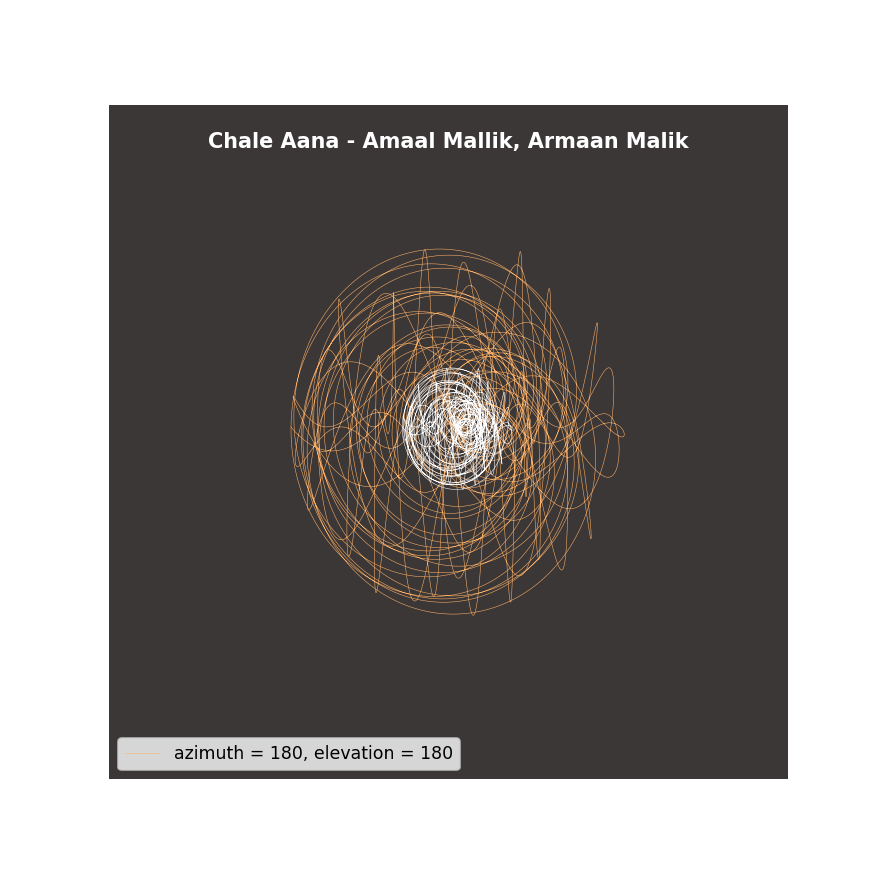

In [57]:
n = 5000 # no. of points
theta = np.linspace(0, 16*np.pi, 5000)
fig = plt.figure(figsize=(7,7))

for j in range(16,17,1):
    images = []

    temp = hypo.iloc[j]
    val = temp['valence']
    x = ((temp['R']-temp['r'])*np.cos(theta) + temp['d']*np.cos(((temp['R']-temp['r'])/temp['r'])*theta))
    y = ((temp['R']-temp['r'])*np.sin(theta) - temp['d']*np.sin(((temp['R']-temp['r'])/temp['r'])*theta))*(np.cos(temp['a']*theta))
    z = ((temp['R']-temp['r'])*np.sin(theta) - temp['d']*np.sin(((temp['R']-temp['r'])/temp['r'])*theta))*(np.sin(temp['a']*theta))

    for i in range(181):
        ax = plt.axes(projection='3d')

        # using 14 values for smoothly varying colours
        if (val>=0 and val<=0.3):
            ax.plot3D(x,y,z,linewidth=0.3,color=color_list_1[(math.floor(i/14)) % 14])
            ax.plot3D(y,x,z,linewidth=0.3,color=color_list_1[(math.floor(i/14)) % 14])
            ax.plot3D(x/3,y/3,z/3,linewidth=0.3,color='#FFE5CC') 
            ax.plot3D(y/3,x/3,z/3,linewidth=0.3,color='#FFE5CC')
        elif (val>0.3 and val<=0.7):
            ax.plot3D(x,y,z,linewidth=0.3,color=color_list_2[(math.floor(i/14)) % 14])
            ax.plot3D(y,x,z,linewidth=0.3,color=color_list_2[(math.floor(i/14)) % 14])
            ax.plot3D(x/3,y/3,z/3,linewidth=0.3,color='#FFFFFF') 
            ax.plot3D(y/3,x/3,z/3,linewidth=0.3,color='#FFFFFF')
        elif (val>0.7 and val<=1):
            ax.plot3D(x,y,z,linewidth=0.3,color=color_list_3[(math.floor(i/14)) % 14])     
            ax.plot3D(y,x,z,linewidth=0.3,color=color_list_3[(math.floor(i/14)) % 14])
            ax.plot3D(x/3,y/3,z/3,linewidth=0.3,color='#66FFFF') 
            ax.plot3D(y/3,x/3,z/3,linewidth=0.3,color='#66FFFF')

        plt.axis('off')
        ax.set_facecolor('#3C3737')
        plt.title("{} - {}".format(temp['song_title'],temp['artists']), c='w', fontweight='bold')

        ax.view_init(elev=i, azim=i)

        plt.legend([f'azimuth = {i}, elevation = {i}'], loc=3)

        if (i >= 0 and i <= 9):
            plt.savefig("Frames\movie00%d.png" % i)
        elif (i >= 10 and i <= 99):   
            plt.savefig("Frames\movie0%d.png" % i)
        elif (i >= 100 and i <= 180):   
            plt.savefig("Frames\movie%d.png" % i)    

    for file in os.listdir('Frames'):
        images.append(imageio.imread('Frames\{}'.format(file)))
        os.remove('Frames\{}'.format(file))
        
    imageio.mimsave("{} - {}.gif".format(temp['song_title'],temp['artists']), images, fps=60)

In [26]:
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.graph_objects as go
init_notebook_mode(connected=True)

theta = np.linspace(0, 16*np.pi, 40000)
temp = hypo.iloc[39]
val = temp['valence']
    
x = ((temp['R']-temp['r'])*np.cos(theta) + temp['d']*np.cos(((temp['R']-temp['r'])/temp['r'])*theta))
y = ((temp['R']-temp['r'])*np.sin(theta) - temp['d']*np.sin(((temp['R']-temp['r'])/temp['r'])*theta))*(np.cos(temp['a']*theta))
z = ((temp['R']-temp['r'])*np.sin(theta) - temp['d']*np.sin(((temp['R']-temp['r'])/temp['r'])*theta))*(np.sin(temp['a']*theta))

layout = go.Layout(title="{} - {}".format(temp['song_title'],temp['artists']),
                   titlefont=dict(size =14, color='white'),
                   paper_bgcolor='#000000')

if (val>=0 and val<=0.3):
    fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z, mode='lines', opacity=0.5, marker=dict(size=0.8,color='#FF6666', opacity=0.2))],
                    layout=layout)
    fig.add_trace(go.Scatter3d(x=y, y=x, z=z, mode='lines', opacity=0.5, marker=dict(size=0.8,color='#FF6666', opacity=0.2)))
    fig.add_trace(go.Scatter3d(x=x/3, y=y/3, z=z/3, mode='lines', opacity=0.5, marker=dict(size=0.8,color='#FFE5CC', opacity=0.2)))
    fig.add_trace(go.Scatter3d(x=y/3, y=x/3, z=z/3, mode='lines', opacity=0.5, marker=dict(size=0.8,color='#FFE5CC', opacity=0.2)))    
elif (val>0.3 and val<=0.7):
    fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z, mode='lines', opacity=0.5, marker=dict(size=0.8,color='#FFFF33', opacity=0.2))],
                    layout=layout)
    fig.add_trace(go.Scatter3d(x=y, y=x, z=z, mode='lines', opacity=0.5, marker=dict(size=0.8,color='#FFFF33', opacity=0.2)))
    fig.add_trace(go.Scatter3d(x=x/3, y=y/3, z=z/3, mode='lines', opacity=0.5, marker=dict(size=0.8,color='#FFFFFF', opacity=0.2)))
    fig.add_trace(go.Scatter3d(x=y/3, y=x/3, z=z/3, mode='lines', opacity=0.5, marker=dict(size=0.8,color='#FFFFFF', opacity=0.2)))
elif (val>0.7 and val<=1):
    fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z, mode='lines', opacity=0.5, marker=dict(size=0.8,color='#99FF99', opacity=0.2))],
                    layout=layout)
    fig.add_trace(go.Scatter3d(x=y, y=x, z=z, mode='lines', opacity=0.5, marker=dict(size=0.8,color='#99FF99', opacity=0.2)))
    fig.add_trace(go.Scatter3d(x=x/3, y=y/3, z=z/3, mode='lines', opacity=0.5, marker=dict(size=0.8,color='#66FFFF', opacity=0.2)))
    fig.add_trace(go.Scatter3d(x=y/3, y=x/3, z=z/3, mode='lines', opacity=0.5, marker=dict(size=0.8,color='#66FFFF', opacity=0.2)))    

fig.update_layout(scene = dict(
                    xaxis = dict(
                         autorange=True,
                         backgroundcolor='rgb(0,0,0)',
                         gridcolor='black',
                         showbackground=False,
                         zerolinecolor='black',
                         ticks='',
                         showticklabels=False),
                    yaxis = dict(
                         autorange=True,
                         backgroundcolor='rgb(0,0,0)',
                         gridcolor='black',
                         showbackground=False,
                         zerolinecolor='black',
                         ticks='',
                         showticklabels=False),
                    zaxis = dict(
                         autorange=True,
                         backgroundcolor='rgb(0,0,0)',
                         gridcolor='black',
                         showbackground=False,
                         zerolinecolor='black',
                         ticks='',
                         showticklabels=False),
                    )
                 ) 

fig.update_layout(autosize=False,
                  width=1000,
                  height=1000)

fig.update_layout(showlegend=False)

fig.show()
fig.write_html("{} - {}.html".format(temp['song_title'],temp['artists']))